# SQL Guided Practice

***

### SQL GP Goals

Explore basic to intermediate SQL queries using python. Concepts covered will include:

- SQLite
- SELECT
    - SELECT AGGREGATES
- WHERE
- LIMIT
- ORDER BY
- LIKE
- GROUP BY
- HAVING
- JOINS

## Tile Matching Examples

## Database

A database is a set of data stored in a computer. This data is usually structured in a way that makes the data easily accessible.

## RDBMS

A relational database is a type of database that contains data that has a relationship with itself in some way. These data are often organized in tables that records within rows and columns. These columns, referred to as keys, allow for the tables in the database to have some relation to one another, through primary and foreign keys.

An RDBMS is a Relational DataBase Management System. The tables in an RDBMS are often visualized with a schema that defines the attributes, data types, and keys of the data. 

In [1]:
# import Image module 
from IPython.display import Image 

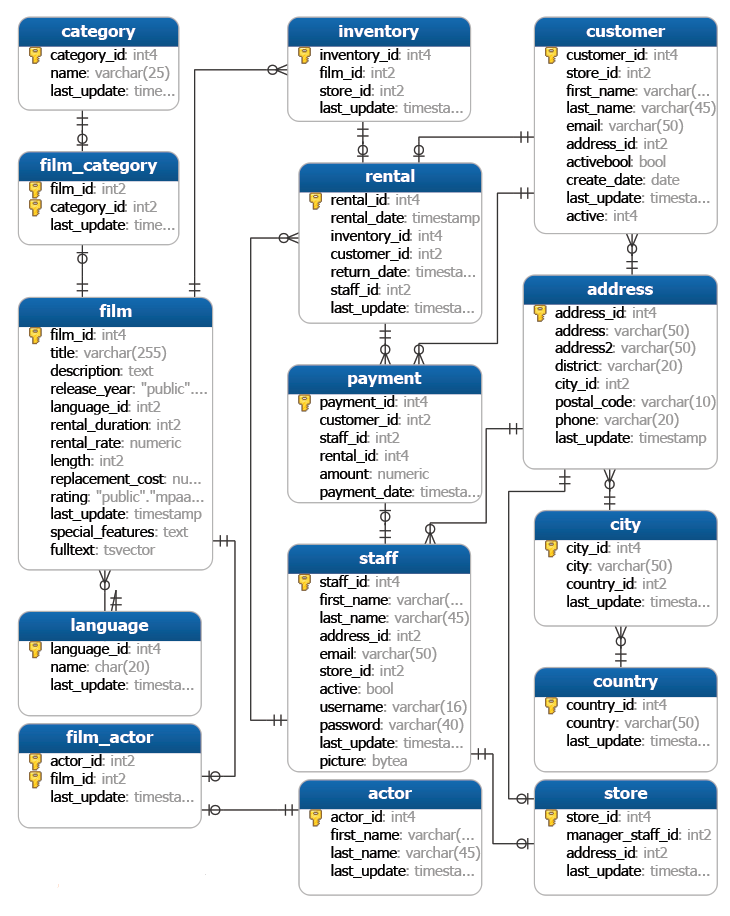

In [2]:
# display schema image
Image(filename='images/example_schema.png')

In [3]:
# view rankings ofRDBMS
# https://db-engines.com/en/

## SQL

Structured data is the data which conforms to a data model, has a well define structure, follows a consistent order and can be easily accessed and used by a person or a computer program.

SQL (Structured Query language) is often used to manage structured data stored in databases.

## SQLlite

SQLite is an RDBMS with a unique set of traits. From the SQLite official page:


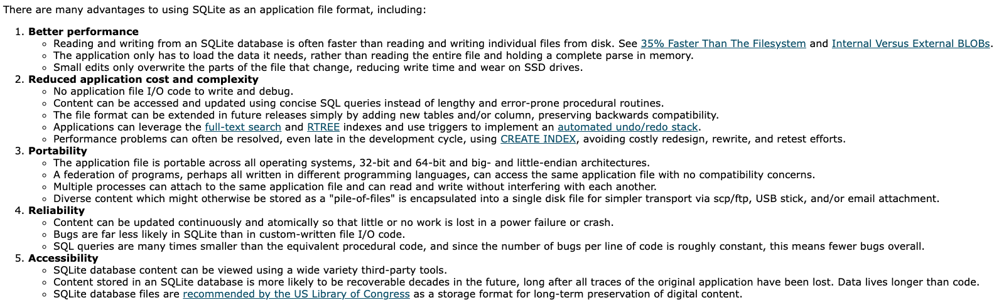

In [4]:
# view image of sqlite path
Image(filename='images/advantages_sqlite.png')

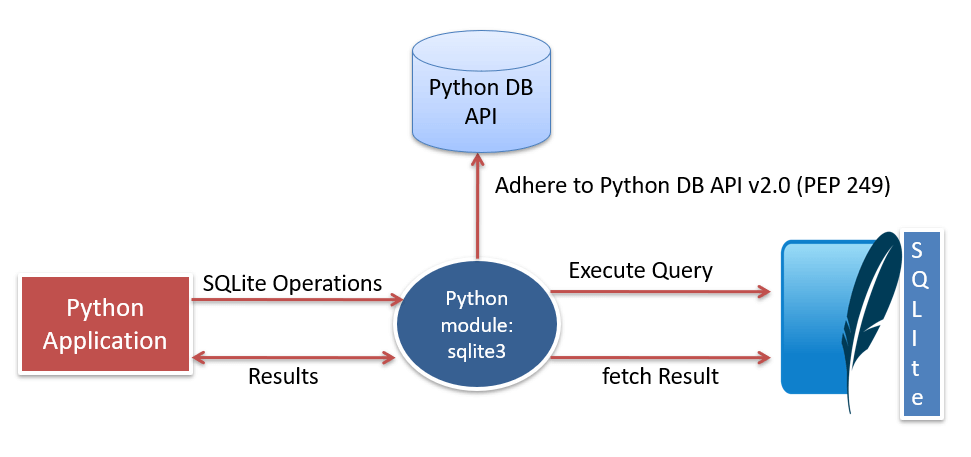

In [5]:
# view image of sqlite path
Image(filename='images/python-sqlite3-module-working.png')

### Import sqlite3 module

`import sqlite3` statement imports the `sqlite3` module in the program. Using the classes and methods defined in the `sqlite3` module we can communicate with the SQLite database.

In [6]:
# import sqlite3
import sqlite3

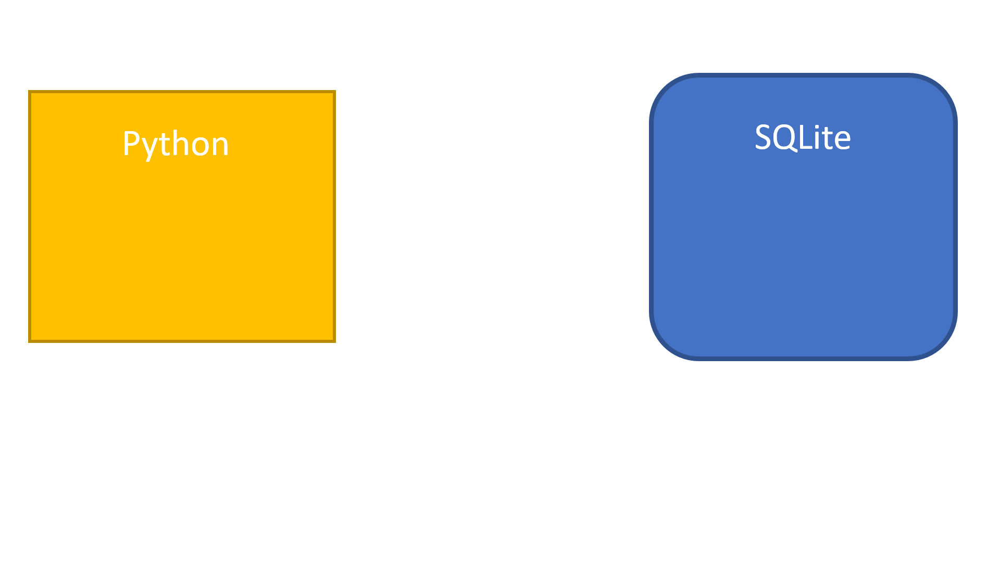

In [7]:
Image(filename='images/sqlconnect.gif')

### Create and/or Connect to database

Use the `connect()` method of the connector class with the database name. 

- To establish a connection to SQLite, you need to pass the database name you want to connect. If you specify the database file name that already presents on the disk, it will connect to it. 
- If your specified SQLite database file doesn’t exist, SQLite creates a new database for you.

This method returns the SQLite Connection Object if the connection is successful.

In [8]:
# create new database
connection = sqlite3.connect('basketball.sqlite')

In [9]:
# if you dont have a .sqlite or .db file
# this will create the file and connect to it
# connection = sqlite3.connect('example_sqlite.db')

### Create Cursor

Using a connection object we can create a cursor object which allows us to execute SQLite command/queries through Python.

In [10]:
import datetime
cursor = connection.cursor()
print("Successfully created and connected to Database." + str(datetime.datetime.now()))

Successfully created and connected to Database.2022-06-17 15:39:18.139901


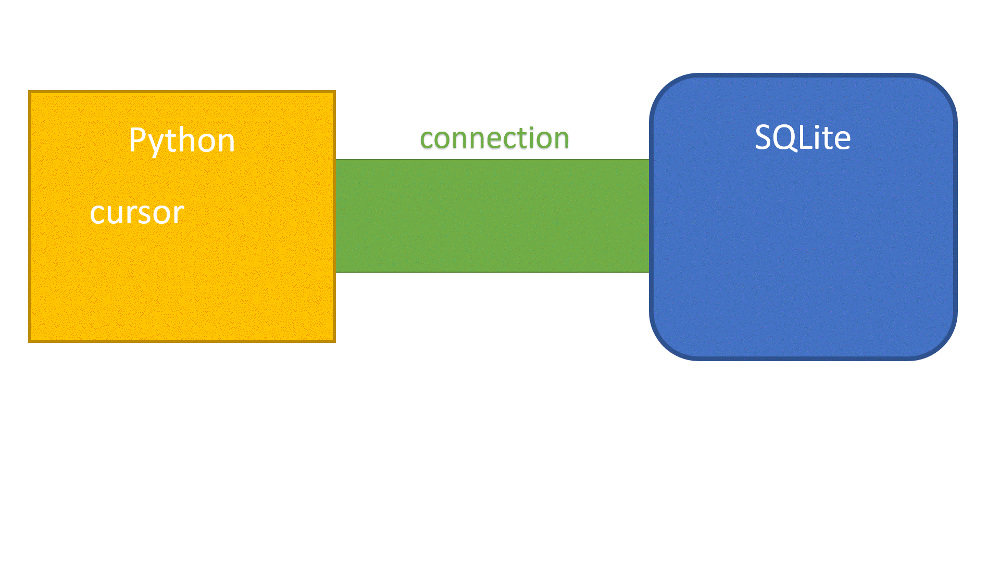

In [11]:
Image(filename='images/sql_cursor.gif')

### Execute

Using the cursor’s `execute()` method we can execute a database operation or query from Python. 

The `cursor.execute()` method takes a SQLite query as a parameter and returns the result Set i.e. nothing but a database row.
We can retrieve query result from resultSet using cursor methods such as `fetchone()`, `fetchmany()`, or `fetchall()`.

## SELECT

### fetchall()

Fetches all (remaining) rows of a query result, returning a list. Note that the cursor’s arraysize attribute can affect the performance of this operation. An empty list is returned when no rows are available.

In [12]:
# sql query for list of tables
tables_query = """SELECT name FROM sqlite_master WHERE type='table';"""
cursor.execute(tables_query)
print(cursor.fetchall())

[('Player',), ('Team',), ('Team_Attributes',), ('Player_Attributes',), ('Team_Salary',), ('Player_Salary',), ('Game',)]


### fetchmany()

Fetches the next set of rows of a query result, returning a list. An empty list is returned when no more rows are available.

The number of rows to fetch per call is specified by the size parameter. If it is not given, the cursor’s arraysize determines the number of rows to be fetched. The method should try to fetch as many rows as indicated by the size parameter. If this is not possible due to the specified number of rows not being available, fewer rows may be returned.

In [13]:
# fetchmany
cursor.execute(tables_query)
print(cursor.fetchmany(5))

[('Player',), ('Team',), ('Team_Attributes',), ('Player_Attributes',), ('Team_Salary',)]


### fetchone()

Fetches the next row of a query result set, returning a single sequence, or None when no more data is available.

In [14]:
# fetchone
cursor.execute(tables_query)
print(cursor.fetchone())

('Player',)


### Creating a DataFrame

It is also possible to create a `pandas` DataFrame using SQL queries. First we will need to import pandas, and can then utilize the `pd.read_sql()` method.

In [15]:
# import pandas with alias
import pandas as pd

# create a pandas DataFrame with SQL query
basket_df = pd.read_sql("""SELECT name FROM sqlite_master WHERE type='table';""", connection)

# view first few rows
basket_df.head()

,name
0,Player
1,Team
2,Team_Attributes
3,Player_Attributes
4,Team_Salary


In [16]:
# Create team DataFrame
team_df = pd.read_sql("""SELECT * FROM Team""",connection)

# view first few rows of team DataFrame
team_df.head()

,id,full_name,abbreviation,nickname,city,state,year_founded
0,1610612737,Atlanta Hawks,ATL,Hawks,Atlanta,Atlanta,1949
1,1610612738,Boston Celtics,BOS,Celtics,Boston,Massachusetts,1946
2,1610612739,Cleveland Cavaliers,CLE,Cavaliers,Cleveland,Ohio,1970
3,1610612740,New Orleans Pelicans,NOP,Pelicans,New Orleans,Louisiana,2002
4,1610612741,Chicago Bulls,CHI,Bulls,Chicago,Illinois,1966


You can also select specific columns by including them in the SELECT statement:

In [17]:
# Create team DataFrame with city and name
team_df = pd.read_sql("""SELECT city, nickname FROM Team""",connection)

# view first few rows of team DataFrame
team_df.head()

,city,nickname
0,Atlanta,Hawks
1,Boston,Celtics
2,Cleveland,Cavaliers
3,New Orleans,Pelicans
4,Chicago,Bulls


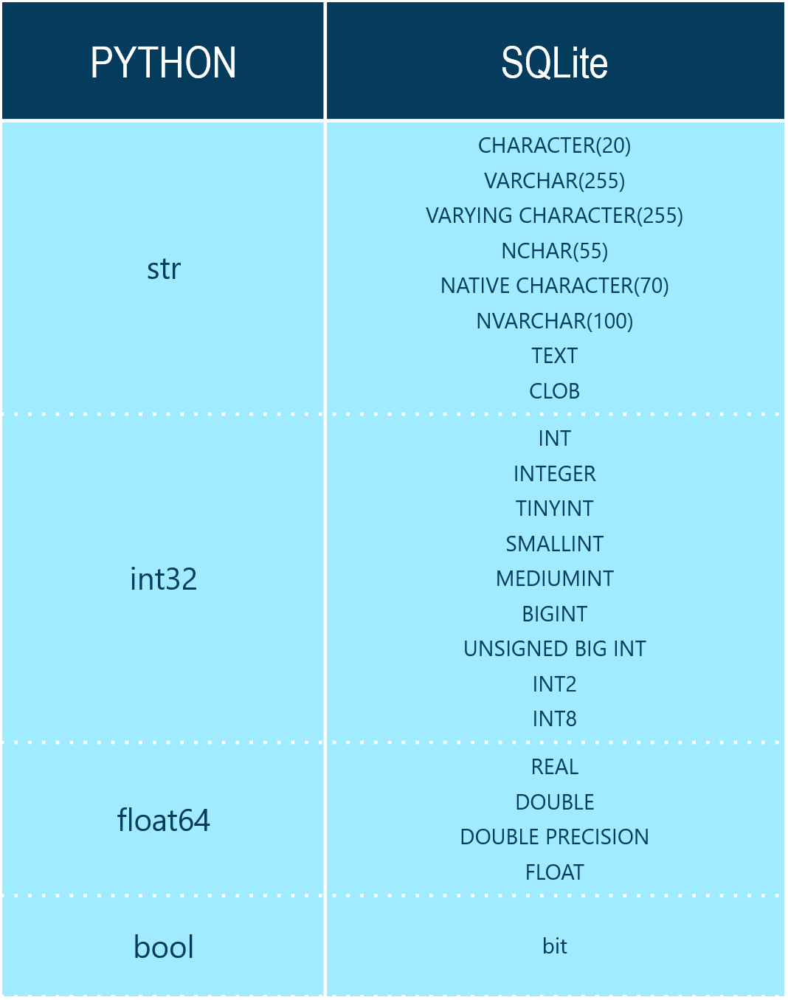

In [18]:
# compare python datatypes & SQLite datatypes
Image(filename='images/python_sqlite.png')

## SELECT DISTINCT

Using the `DISTINCT` clause will remove duplicate rows from the results. 

`DISTINCT` can be used on one or more columns of a table.

Use the `DISTINCT` clause to view all the unique NBA teams in the dataset

In [19]:
# query for all the teams in the NBA
unique_teams = pd.read_sql("""SELECT DISTINCT full_name FROM Team""",connection)

# view unique teams
unique_teams

,full_name
0,Atlanta Hawks
1,Boston Celtics
2,Cleveland Cavaliers
3,New Orleans Pelicans
4,Chicago Bulls
5,Dallas Mavericks
6,Denver Nuggets
7,Golden State Warriors
8,Houston Rockets
9,Los Angeles Clippers


## SELECT Aggregates

There are a number of aggregate functions that can be used in conjunction with SELECT to pull minimum, maximum, average, etc. 

### COUNT

The `COUNT` function will return the frequency, or count of the input rows that match a certain condition. COUNT does not work without a parenthesis: 

`COUNT()`

COUNT can be passed on a column like so:

In [20]:
# query for the count of all the teams in the NBA
count_teams = pd.read_sql("""SELECT COUNT(full_name) FROM Team""",connection)

# view count of unique teams
count_teams

,COUNT(full_name)
0,30


#### AS

We can use the AS clause to change the name of a column returned.

In [21]:
# query for the count of all the teams in the NBA
count_teams = pd.read_sql("""SELECT COUNT(full_name) AS unique_teams FROM Team""",connection)

# view count of unique teams
count_teams

,unique_teams
0,30


In [46]:
# return the number of unique founding years
count_teams = pd.read_sql("""SELECT COUNT(DISTINCT year_founded) FROM Team""",connection)
count_teams

,COUNT(DISTINCT year_founded)
0,15


### AVG

In [23]:
# Create team salary DataFrame
psalary_df = pd.read_sql("""SELECT * FROM Player_Salary""",connection)

# view first few rows of team salary DataFrame
psalary_df.head()

,slugSeason,nameTeam,namePlayer,statusPlayer,isFinalSeason,isWaived,isOnRoster,isNonGuaranteed,isTeamOption,isPlayerOption,typeContractDetail,value
0,2020-21,Atlanta Hawks,Bogdan Bogdanovic,current roster,0,0,1,0,0,0,Guaranteed,18000000.0
1,2021-22,Atlanta Hawks,Bogdan Bogdanovic,current roster,0,0,1,0,0,0,Guaranteed,18000000.0
2,2022-23,Atlanta Hawks,Bogdan Bogdanovic,current roster,0,0,1,0,0,0,Guaranteed,18000000.0
3,2023-24,Atlanta Hawks,Bogdan Bogdanovic,current roster,1,0,1,0,0,1,Player Option,18000000.0
4,2020-21,Atlanta Hawks,Brandon Goodwin,current roster,0,0,1,0,0,0,Guaranteed,1701593.0


In [24]:
# What is the average player's salary
avg_psalary = pd.read_sql("""SELECT AVG(value) AS avg_value FROM Player_Salary""",connection)

# view first few rows of team salary DataFrame
avg_psalary

,avg_value
0,9.762008e+06


### SUM

We can gather the total of values in a column using the SUM function. For example if we wanted to get the total number of players who have their final season in contract, we could call:

In [25]:
# What is the average player's salary
end_season = pd.read_sql("""SELECT SUM(isFinalSeason) AS total_end_contracts FROM Player_Salary""",connection)

# view first few rows of team salary DataFrame
end_season

,total_end_contracts
0,452


Let's compare this value to the total number of players in the dataset.

In [26]:
# total unique players in dataset
end_season = pd.read_sql("""SELECT COUNT(DISTINCT namePlayer) AS total_players
                            FROM Player_Salary""",connection)

# view first few rows of team salary DataFrame
end_season

,total_players
0,520


### MAX

If we wanted to know the highest paid NBA player, we could use the MAX function:

In [27]:
# query the highest paid player in the dataset
# return their name, team, and pay
most_paid = pd.read_sql("""SELECT namePlayer, nameTeam, MAX(value) as highest_pay
                            FROM Player_Salary""",connection)

# view the highest paid player in the dataset
most_paid

,namePlayer,nameTeam,highest_pay
0,Paul George,Los Angeles Clippers,48787676.0


### MIN

Similar to the `MAX` function, we can pull the minimum value from a dataset using the `MIN` :

In [28]:
# query the lowest paid player in the dataset
# return their name, team, and pay
least_paid = pd.read_sql("""SELECT namePlayer, MIN(value) as lowest_pay
                            FROM Player_Salary""",connection)

# view the least paid player in the dataset
least_paid

,namePlayer,lowest_pay
0,Andrew White,25000.0


## WHERE

The `WHERE` clause allows us to query our data with a conditional. The comparison operators we can use are:
    
- `=` *Equal*
- `>` *Greater than*
- `<` *Less than*
- `>=` Greater than or equal
- `<=` Less than or equal
- `<>` or `!=` Not equal
- `AND` Logical operator for needing to meet all conditions
- `OR` Logical operator for needing to meet only one of the conditions

The `WHERE` clause should appear right after the `FROM` clause of the `SELECT` statement.

In [29]:
# view the 2021-22 rows from Player_Salary
last_season_df = pd.read_sql_query('''SELECT * 
                                    FROM Player_Salary 
                                    WHERE slugSeason = '2021-22';''', connection)
last_season_df.head()

,slugSeason,nameTeam,namePlayer,statusPlayer,isFinalSeason,isWaived,isOnRoster,isNonGuaranteed,isTeamOption,isPlayerOption,typeContractDetail,value
0,2021-22,Atlanta Hawks,Bogdan Bogdanovic,current roster,0,0,1,0,0,0,Guaranteed,18000000.0
1,2021-22,Atlanta Hawks,Brandon Goodwin,current roster,1,0,1,0,0,0,Qualifying Offer,2126991.0
2,2021-22,Atlanta Hawks,Bruno Fernando,current roster,0,0,1,0,0,0,Guaranteed,1782621.0
3,2021-22,Atlanta Hawks,Cam Reddish,current roster,0,0,1,0,0,0,Guaranteed,4670160.0
4,2021-22,Atlanta Hawks,Clint Capela,current roster,0,0,1,0,0,0,Guaranteed,17103448.0


In [30]:
# return the average pay of a team
# using the WHERE clause
hawks_last_season = pd.read_sql_query('''SELECT nameTeam, AVG(value) AS avg_pay 
                                    FROM Player_Salary 
                                    WHERE nameTeam = 'Atlanta Hawks';''', connection)
# view results
hawks_last_season

,nameTeam,avg_pay
0,Atlanta Hawks,8.945488e+06


## LIMIT

The `LIMIT` clause set the count of rows returned from a query. `LIMIT` should be the last clasue called.

In [31]:
# return the players in 2021-22
# paid more than thirty million USD
# limited to ten rows
thirty_mil_player = pd.read_sql_query('''SELECT namePlayer, nameTeam, value
                                    FROM Player_Salary 
                                    WHERE value >= 30000000 AND slugSeason = '2021-22'
                                    LIMIT 10;''', connection)
# view results
thirty_mil_player

,namePlayer,nameTeam,value
0,Kemba Walker,Boston Celtics,36016200.0
1,James Harden,Brooklyn Nets,44310840.0
2,Kevin Durant,Brooklyn Nets,42018900.0
3,Kyrie Irving,Brooklyn Nets,35053700.0
4,Kevin Love,Cleveland Cavaliers,31258256.0
5,Kristaps Porzingis,Dallas Mavericks,31650600.0
6,Nikola Jokic,Denver Nuggets,31579390.0
7,Andrew Wiggins,Golden State Warriors,31579390.0
8,Klay Thompson,Golden State Warriors,37980720.0
9,Stephen Curry,Golden State Warriors,45780966.0


Text(0.5, 0, 'Contract Value USD')

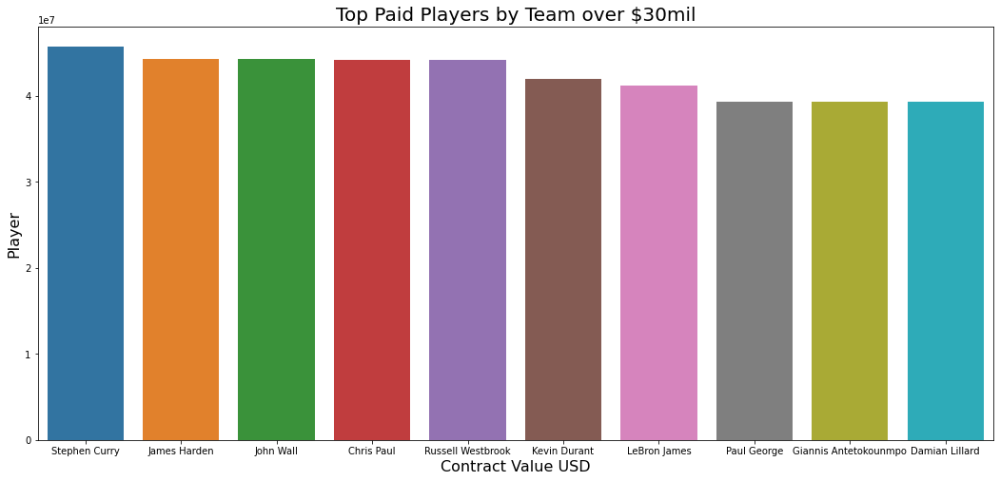

In [58]:
# import seaborn as sns
import seaborn as sns
# import matplotlib as plt
import matplotlib.pyplot as plt
%matplotlib inline

# visualize player by value
# Create our plot
fig, ax = plt.subplots(figsize=(18,8))
sns.barplot(x = 'namePlayer', y = 'value', data= thirty_mil_player)

# Set our titles
ax.set_title('Top Paid Players by Team over $30mil', fontsize=20)
ax.set_ylabel('Player', fontsize=16)
ax.set_xlabel('Contract Value USD', fontsize=16)

## ORDER BY

We can use the `ORDER BY` clause to order our rows returned by a certain column. We can set this order in:
    
- ASC *Ascending Order*: begins with the least or smallest and ends with the greatest or largest
- DESC *Descending Order*: begins with the greatest or largest and ends with the least or smallest

In [32]:
# set a descending order to thiry_mil_player
thirty_mil_player = pd.read_sql_query('''SELECT namePlayer, nameTeam, value
                                    FROM Player_Salary 
                                    WHERE value >= 30000000 AND slugSeason = '2021-22'
                                    ORDER BY value DESC
                                    LIMIT 10;''', connection)
# view results
thirty_mil_player

,namePlayer,nameTeam,value
0,Stephen Curry,Golden State Warriors,45780966.0
1,James Harden,Brooklyn Nets,44310840.0
2,John Wall,Houston Rockets,44310840.0
3,Chris Paul,Phoenix Suns,44211146.0
4,Russell Westbrook,Washington Wizards,44211146.0
5,Kevin Durant,Brooklyn Nets,42018900.0
6,LeBron James,Los Angeles Lakers,41180544.0
7,Paul George,Los Angeles Clippers,39344900.0
8,Giannis Antetokounmpo,Milwaukee Bucks,39344900.0
9,Damian Lillard,Portland Trail Blazers,39344900.0


In [33]:
# return the players in 2021-22
# paid less than ten million USD
# limited to ten rows in descending order
# set a descending order to thiry_mil_player
ten_mil_player = pd.read_sql_query('''SELECT namePlayer, nameTeam, value
                                    FROM Player_Salary 
                                    WHERE value < 10000000 AND slugSeason = '2021-22'
                                    ORDER BY value DESC
                                    LIMIT 10;''', connection)
# view results
ten_mil_player

,namePlayer,nameTeam,value
0,Kyle Anderson,Memphis Grizzlies,9937150.0
1,DeAndre Jordan,Brooklyn Nets,9881598.0
2,Tristan Thompson,Boston Celtics,9720900.0
3,Serge Ibaka,Los Angeles Clippers,9720900.0
4,Montrezl Harrell,Los Angeles Lakers,9720900.0
5,Jae Crowder,Phoenix Suns,9720900.0
6,Derrick Jones,Portland Trail Blazers,9720900.0
7,Derrick Favors,Utah Jazz,9720900.0
8,Ja Morant,Memphis Grizzlies,9603360.0
9,Jaren Jackson Jr,Memphis Grizzlies,9180560.0


## LIKE

`LIKE` is another operator we can use along side `WHERE` to help filter our query. With `LIKE` we can find patterns, or common sequences of characters.

The syntax for the `LIKE` clause is generally:

WHERE namePlayer LIKE 'Ja%';

Notice the use of `%` in our statement. Here, `%` is a wildcard character for the pattern we want `LIKE` to recognize.

The above query would return the rows with values in the first_name column that start with `Ja`, and followed by any other characters afterwards.

In [34]:
# return the player's name, team name, and value
# from Player_Salary where name starts with characters: 'Tr'
tr_players = pd.read_sql_query('''SELECT namePlayer, nameTeam, value
                                    FROM Player_Salary
                                    WHERE namePlayer LIKE 'Tr%';''', connection)

# view query
tr_players

,namePlayer,nameTeam,value
0,Trae Young,Atlanta Hawks,6571800.0
1,Trae Young,Atlanta Hawks,8326471.0
2,Trae Young,Atlanta Hawks,11040900.0
3,Tremont Waters,Boston Celtics,1669178.0
4,Tristan Thompson,Boston Celtics,9258000.0
5,Tristan Thompson,Boston Celtics,9720900.0
6,Troy Brown Jr,Chicago Bulls,3372840.0
7,Troy Brown Jr,Chicago Bulls,5170564.0
8,Troy Brown Jr,Chicago Bulls,7228448.0
9,Trey Burke,Dallas Mavericks,3000000.0


## GROUP BY

The `GROUP BY` clause bins the returned rows in groups that can have functions applied to them.
    
For instance, if we wanted to calculate the average contract payout for teams during the 2021-2022 season, after our `WHERE` clause we could group the returned rows by `nameTeam`. 

This would group all of the rows by their team, and calculate the average value of those binned contracts.

Calculate the average contract payout for teams during the 2021-22 season.

In [35]:
# return the team name and average pay for each
# team with WHERE and GROUP BY
last_season_df = pd.read_sql_query('''SELECT nameTeam, AVG(value) AS avg_pay
                                    FROM Player_Salary 
                                    WHERE slugSeason = '2021-22'
                                    GROUP BY nameTeam''', connection)
# view results
last_season_df.head()

,nameTeam,avg_pay
0,Atlanta Hawks,8.610710e+06
1,Boston Celtics,9.039872e+06
2,Brooklyn Nets,1.729410e+07
3,Charlotte Hornets,6.999485e+06
4,Chicago Bulls,9.324802e+06


Now let's view the 5 highest paying teams for the 2021-22 season.

In [36]:
# return the team name and average pay for 
# the top 5 highest average paying teams 
# with WHERE and GROUP BY and ORDER BY
last_season_highest = pd.read_sql_query('''SELECT nameTeam, AVG(value) AS avg_pay
                                    FROM Player_Salary 
                                    WHERE slugSeason = '2021-22'
                                    GROUP BY nameTeam
                                    ORDER BY avg_pay DESC;''', connection)
last_season_highest.head()

,nameTeam,avg_pay
0,Brooklyn Nets,1.729410e+07
1,Phoenix Suns,1.386981e+07
2,Golden State Warriors,1.365000e+07
3,Los Angeles Clippers,1.349968e+07
4,Los Angeles Lakers,1.255322e+07


In [37]:
# Create team salary DataFrame
tsalary_df = pd.read_sql("""SELECT * FROM Team_Salary""",connection)

# view first few rows of team salary DataFrame
tsalary_df.head()

,nameTeam,slugTeam,urlTeamSalaryHoopsHype,X2020-21,X2021-22,X2022-23,X2023-24,X2024-25,X2025-26
0,Atlanta Hawks,ATL,http://hoopshype.com/salaries/atlanta_hawks/,118647039.0,95496087.0,59656896.0,18000000.0,0.0,0.0
1,Boston Celtics,BOS,http://hoopshype.com/salaries/boston_celtics/,132032864.0,132077647.0,95626895.0,62027548.0,34844000.0,37092000.0
2,Brooklyn Nets,BKN,http://hoopshype.com/salaries/brooklyn_nets/,168854452.0,165982367.0,157168219.0,19928571.0,0.0,0.0
3,Charlotte Hornets,CHA,http://hoopshype.com/salaries/charlotte_hornets/,108218809.0,83125939.0,44614401.0,31500000.0,0.0,0.0
4,Chicago Bulls,CHI,http://hoopshype.com/salaries/chicago_bulls/,128963580.0,96304124.0,22000000.0,0.0,0.0,0.0


## HAVING

The `HAVING` clause is a tool we can use along side `GROUP BY` to filter group rows based on another condition.

For instance, if we wanted to find the highest contract for each Team, but only if that contract was worth more than thity million USD we could use the `HAVING CLAUSE`.

In [38]:
# return the highest contracts for each team over $30mil
over_thy_team = pd.read_sql_query('''SELECT namePlayer, nameTeam, slugSeason, MAX(value) as top_pay
                                    FROM Player_Salary
                                    GROUP BY nameTeam
                                    HAVING top_pay > 30000000;''', connection)

# view results
over_thy_team

,namePlayer,nameTeam,slugSeason,top_pay
0,Kemba Walker,Boston Celtics,2022-23,37653300.0
1,James Harden,Brooklyn Nets,2022-23,47366760.0
2,Gordon Hayward,Charlotte Hornets,2023-24,31500000.0
3,Kevin Love,Cleveland Cavaliers,2020-21,31258256.0
4,Kristaps Porzingis,Dallas Mavericks,2023-24,36016200.0
5,Jamal Murray,Denver Nuggets,2024-25,36016200.0
6,Blake Griffin,Detroit Pistons,2020-21,32670565.0
7,Stephen Curry,Golden State Warriors,2021-22,45780966.0
8,John Wall,Houston Rockets,2022-23,47366760.0
9,Paul George,Los Angeles Clippers,2024-25,48787676.0


## JOINS

Suppose we would like to join the `Player_Salary` table with the `Player_Attributes` table, first we would need to take a look at the columns of the `Player_Attributes` to see which columns, or keys we can match the tables on. 

Here we look for primary and foreign keys that share the same value between the tables we want to join on.

In [39]:
# display all columns in a dataset
pd.set_option('display.max_columns', None)

# Create team DataFrame
pstats_df = pd.read_sql("""SELECT * FROM 'Player_Attributes'""",connection)

# view first few rows of team DataFrame
pstats_df.head()

,ID,FIRST_NAME,LAST_NAME,DISPLAY_FIRST_LAST,DISPLAY_LAST_COMMA_FIRST,DISPLAY_FI_LAST,PLAYER_SLUG,BIRTHDATE,SCHOOL,COUNTRY,LAST_AFFILIATION,HEIGHT,WEIGHT,SEASON_EXP,JERSEY,POSITION,ROSTERSTATUS,GAMES_PLAYED_CURRENT_SEASON_FLAG,TEAM_ID,TEAM_NAME,TEAM_ABBREVIATION,TEAM_CODE,TEAM_CITY,PLAYERCODE,FROM_YEAR,TO_YEAR,DLEAGUE_FLAG,NBA_FLAG,GAMES_PLAYED_FLAG,DRAFT_YEAR,DRAFT_ROUND,DRAFT_NUMBER,PTS,AST,REB,ALL_STAR_APPEARANCES,PIE
0,76001,Alaa,Abdelnaby,Alaa Abdelnaby,"Abdelnaby, Alaa",A. Abdelnaby,alaa-abdelnaby,1968-06-24T00:00:00,Duke,USA,Duke/USA,82.0,240.0,4,30,Forward,Inactive,N,1610612757,Trail Blazers,POR,blazers,Portland,HISTADD_alaa_abdelnaby,1990,1994,N,Y,Y,1990,1,25,5.7,0.3,3.3,0.0,NaN
1,76002,Zaid,Abdul-Aziz,Zaid Abdul-Aziz,"Abdul-Aziz, Zaid",Z. Abdul-Aziz,zaid-abdul-aziz,1946-04-07T00:00:00,Iowa State,USA,Iowa State/USA,81.0,235.0,9,54,Center,Inactive,N,1610612745,Rockets,HOU,rockets,Houston,HISTADD_zaid_abdul-aziz,1968,1977,N,Y,Y,1968,1,5,9.0,1.2,8.0,0.0,NaN
2,76003,Kareem,Abdul-Jabbar,Kareem Abdul-Jabbar,"Abdul-Jabbar, Kareem",K. Abdul-Jabbar,kareem-abdul-jabbar,1947-04-16T00:00:00,UCLA,USA,UCLA/USA,86.0,225.0,19,33,Center,Inactive,N,1610612747,Lakers,LAL,lakers,Los Angeles,HISTADD_kareem_abdul-jabbar,1969,1988,N,Y,Y,1969,1,1,24.6,3.6,11.2,18.0,NaN
3,51,Mahmoud,Abdul-Rauf,Mahmoud Abdul-Rauf,"Abdul-Rauf, Mahmoud",M. Abdul-Rauf,mahmoud-abdul-rauf,1969-03-09T00:00:00,Louisiana State,USA,Louisiana State/USA,73.0,162.0,8,1,Guard,Inactive,N,1610612743,Nuggets,DEN,nuggets,Denver,mahmoud_abdul-rauf,1990,2000,N,Y,Y,1990,1,3,14.6,3.5,1.9,0.0,NaN
4,1505,Tariq,Abdul-Wahad,Tariq Abdul-Wahad,"Abdul-Wahad, Tariq",T. Abdul-Wahad,tariq-abdul-wahad,1974-11-03T00:00:00,San Jose State,France,San Jose State/France,78.0,235.0,6,9,Forward-Guard,Inactive,N,1610612758,Kings,SAC,kings,Sacramento,tariq_abdul-wahad,1997,2003,N,Y,Y,1997,1,11,7.8,1.1,3.3,0.0,NaN


Now to join the two tables, we can use the `JOIN` clause.

There are a number of types of `JOINS` described by this graphic by *C.L. Moffatt*.

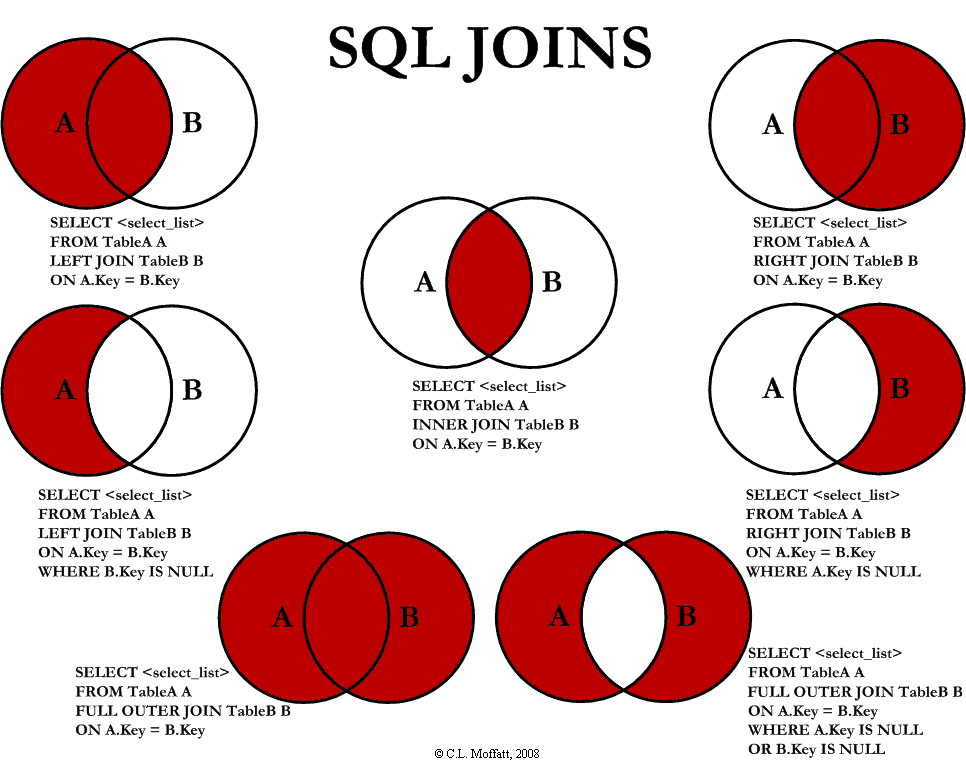

In [40]:
# Show Joins
Image(filename='images/joins.jpeg')

In this case we want to use an inner join to join where the values are equal to one another in a shared column or group of columns.

Here we will join `Player_Salary.namePlayer` with `Player_Attributes.DISPLAY_FIRST_LAST`. 

We will select a few statistics from `Player_Attributes` including

- COUNTRY 
- HEIGHT
- WEIGHT
- POSITION
- PTS
- AST
- REB

In [41]:
# join Player_Salary with Player_Attributes
pstats_merged = pd.read_sql("""SELECT namePlayer, nameTeam, value, COUNTRY, HEIGHT, WEIGHT, POSITION, PTS, AST, REB
                            FROM 'Player_Salary'
                            INNER JOIN Player_Attributes
                            ON Player_Salary.namePlayer = Player_Attributes.DISPLAY_FIRST_LAST
                            """, connection)
# view results
pstats_merged.head()

,namePlayer,nameTeam,value,COUNTRY,HEIGHT,WEIGHT,POSITION,PTS,AST,REB
0,Bogdan Bogdanovic,Atlanta Hawks,18000000.0,Serbia,78.0,220.0,Guard,9.6,2.3,3.3
1,Bogdan Bogdanovic,Atlanta Hawks,18000000.0,Serbia,78.0,220.0,Guard,9.6,2.3,3.3
2,Bogdan Bogdanovic,Atlanta Hawks,18000000.0,Serbia,78.0,220.0,Guard,9.6,2.3,3.3
3,Bogdan Bogdanovic,Atlanta Hawks,18000000.0,Serbia,78.0,220.0,Guard,9.6,2.3,3.3
4,Brandon Goodwin,Atlanta Hawks,1701593.0,USA,72.0,180.0,Guard,3.9,1.6,1.0


In [42]:
# join Player_Salary with Player_Attributes
# for the 2021-22 season
pstats_merged = pd.read_sql("""SELECT namePlayer, nameTeam, value, COUNTRY, HEIGHT, WEIGHT, POSITION, PTS, AST, REB
                            FROM 'Player_Salary'
                            INNER JOIN Player_Attributes
                            ON Player_Salary.namePlayer = Player_Attributes.DISPLAY_FIRST_LAST
                            WHERE slugSeason = '2021-22' 
                            """, connection)
# view results
pstats_merged.head()

,namePlayer,nameTeam,value,COUNTRY,HEIGHT,WEIGHT,POSITION,PTS,AST,REB
0,Bogdan Bogdanovic,Atlanta Hawks,18000000.0,Serbia,78.0,220.0,Guard,9.6,2.3,3.3
1,Brandon Goodwin,Atlanta Hawks,2126991.0,USA,72.0,180.0,Guard,3.9,1.6,1.0
2,Bruno Fernando,Atlanta Hawks,1782621.0,Angola,81.0,240.0,Forward-Center,1.5,0.4,3.0
3,Cam Reddish,Atlanta Hawks,4670160.0,USA,80.0,218.0,Forward-Guard,11.2,1.3,4.0
4,Clint Capela,Atlanta Hawks,17103448.0,Switzerland,82.0,240.0,Center,14.3,0.9,14.2


Now let's say we would like to view the statistics of the highest paid player by team. 

In [43]:
# join Player_Salary with Player_Attributes
# for the 2021-22 season
pstats_merged = pd.read_sql("""SELECT namePlayer, nameTeam, MAX(value), COUNTRY, HEIGHT, WEIGHT, POSITION, PTS, AST, REB
                            FROM 'Player_Salary'
                            INNER JOIN Player_Attributes
                            ON Player_Salary.namePlayer = Player_Attributes.DISPLAY_FIRST_LAST
                            WHERE slugSeason = '2021-22'
                            GROUP BY nameTeam
                            """, connection)
# view results
pstats_merged.head()

,namePlayer,nameTeam,MAX(value),COUNTRY,HEIGHT,WEIGHT,POSITION,PTS,AST,REB
0,Danilo Gallinari,Atlanta Hawks,20475000.0,Italy,82.0,233.0,Forward,12.8,1.5,3.9
1,Kemba Walker,Boston Celtics,36016200.0,USA,72.0,184.0,Guard,17.7,4.6,3.6
2,James Harden,Brooklyn Nets,44310840.0,USA,77.0,220.0,Guard,25.3,11.2,7.9
3,Gordon Hayward,Charlotte Hornets,29925000.0,USA,79.0,225.0,Forward,20.4,4.2,5.6
4,Nikola Vucevic,Chicago Bulls,24000000.0,Montenegro,83.0,260.0,Center,24.5,3.8,11.7


And if we would like to view the statistics of the highest paid player by team only if that contract was over $30mil:

In [44]:
# join Player_Salary with Player_Attributes
# for the 2021-22 season over $30 mil
# ordered by value in descending order
pstats_merged = pd.read_sql("""SELECT namePlayer, nameTeam, MAX(value) as top_pay, COUNTRY, HEIGHT, WEIGHT, POSITION, PTS, AST, REB
                            FROM 'Player_Salary'
                            INNER JOIN Player_Attributes
                            ON Player_Salary.namePlayer = Player_Attributes.DISPLAY_FIRST_LAST
                            WHERE value > 30000000 AND slugSeason = '2021-22'
                            GROUP BY nameTeam
                            ORDER BY value DESC
                            """, connection)
# view results
pstats_merged.head()
                                    

,namePlayer,nameTeam,top_pay,COUNTRY,HEIGHT,WEIGHT,POSITION,PTS,AST,REB
0,Stephen Curry,Golden State Warriors,45780966.0,USA,75.0,185.0,Guard,29.0,6.2,5.3
1,John Wall,Houston Rockets,44310840.0,USA,75.0,210.0,Guard,21.1,6.3,3.5
2,James Harden,Brooklyn Nets,44310840.0,USA,77.0,220.0,Guard,25.3,11.2,7.9
3,Russell Westbrook,Washington Wizards,44211146.0,USA,75.0,200.0,Guard,21.7,10.3,9.5
4,Chris Paul,Phoenix Suns,44211146.0,USA,72.0,175.0,Guard,15.7,8.8,4.7


### Close

Ideally, applications should finalize all prepared statements, close all BLOB handles, and finish all sqlite3_backup objects associated with the sqlite3 object prior to attempting to close the object. 

If the database connection is associated with unfinalized prepared statements, BLOB handlers, and/or unfinished sqlite3_backup objects then sqlite3_close() will leave the database connection open and return SQLITE_BUSY.

In [ ]:
# conn.close()